# <center>Análisis Complejidad Electoral 2019: Municipios <center>
## <center>Resumen de resultados y Mapas <center>

<br>

#### <center>INFOTEC-Maestría en Ciencia de Datos e Información <center>
#### <center>Autor: Miguel David Alvarez Hernández (mdalvarezh@gmail.com)<center>

In [1]:
import datetime
now = datetime.datetime.now()
print ("Última versión:")
print (now.strftime("%Y-%m-%d %H:%M:%S"))

Última versión:
2020-09-19 17:36:39


# Setup

In [2]:
import pandas as pd  
import numpy as np
import pandas_profiling
from itertools import combinations 
from dateutil.parser import parse 
import matplotlib as mpl
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import seaborn as sns
import plotly
import plotly.express as px

In [3]:
#se define diccionario de colores
colors = dict({'G0':'blue',
                  'G1':'green',
                  'G2': 'orange',
                  'G3': 'grey',
                  'G4': 'red',
                  'G5': 'magenta'})

# Importación de resultados

In [4]:
#se carga el dataframe con los resultados de 7 indicadores (todos los PCA considerados en k-medias):
resultados_ind7 = pd.read_csv("C:/Users/miguel.alvarez/Google Drive/INFOTEC/Proyecto/Code-Data/Mun/3_Agrupamiento-Kmeans/Resultados_Mun_Indic_PCA_Kmeans_Atip_ind7.csv", dtype={'EDO':int,'MUN':int})

#se carga el dataframe con los resultados de 7 indicadores, con log en LNE y Densidad_LNE (todos los PCA considerados en k-medias):
resultados_ind7_tf = pd.read_csv("C:/Users/miguel.alvarez/Google Drive/INFOTEC/Proyecto/Code-Data/Mun/3_Agrupamiento-Kmeans/Resultados_Mun_Indic_PCA_Kmeans_Atip_ind7_tf.csv", dtype={'EDO':int,'MUN':int})
#se aplica np.exp rn LNE y Densidad_LNE para volver a las magnitudes originales
resultados_ind7_tf['log(LNE)'] = np.floor(np.exp(resultados_ind7_tf['log(LNE)']))
resultados_ind7_tf['log(Densidad_LNE)'] = np.exp(resultados_ind7_tf['log(Densidad_LNE)'])

#renombramos algunas columnas
resultados_ind7_tf=resultados_ind7_tf.rename(columns={"log(LNE)": "LNE", "log(Densidad_LNE)": "Densidad_LNE"})
resultados_ind7_tf

,EDO,NOMBRE_ESTADO,MUN,NOMBRE_MUNICIPIO,NUM_SECC_RUR,LNE,Densidad_LNE,Razon_LNE_PE,TC_LNE_2019,Coef_Var_LNE,...,Autocorr_LNE,CP1 (ICE principal),CP2 (segundo ICE),CP3 (tercer ICE),CP4,CP5,CP6,CP7,TCE_municipal,Atipicidad
0,1,AGUASCALIENTES,10,SAN FRANCISCO DE LOS ROMO,3,34916.0,3566.024547,0.989272,0.037498,0.015085,...,0.755939,-0.995331,0.745533,-1.389633,0.434649,0.105639,-0.259502,-0.196240,G3,Tipica
1,1,AGUASCALIENTES,8,SAN JOSE DE GRACIA,4,6914.0,46.444421,0.991803,0.000289,0.008345,...,0.237061,-3.318903,-0.619987,0.723898,0.193995,-0.969311,-0.651817,-1.034857,G0,Tipica
2,1,AGUASCALIENTES,9,TEPEZALA,6,15544.0,2478.675412,0.990635,0.005108,0.011777,...,0.344567,-2.757468,0.081456,-0.908153,1.115722,-0.558179,-0.004696,-0.705979,G0,Tipica
3,1,AGUASCALIENTES,11,EL LLANO,6,15066.0,1505.749552,0.991016,-0.003373,0.012239,...,0.504020,-2.523745,0.260810,-0.738536,0.676101,-0.383889,-0.048412,-0.126217,G0,Tipica
4,1,AGUASCALIENTES,2,ASIENTOS,11,34222.0,1484.722551,0.989080,0.001874,0.013432,...,0.374738,-2.490247,0.453746,-0.450692,1.507864,-0.496284,-0.207700,-0.497406,G0,Tipica
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2453,32,ZACATECAS,45,TEPECHITLAN,13,6958.0,36.438707,0.983523,0.066677,0.019408,...,0.959378,0.566375,-0.038837,1.137560,-0.402981,0.304617,0.000411,-0.066702,G3,Tipica
2454,32,ZACATECAS,14,GENERAL FRANCISCO R. MURGUIA,32,17372.0,14.595272,0.986450,0.082705,0.022769,...,0.984897,1.080969,1.300230,2.208190,-0.057168,-0.342807,0.496959,-0.236424,G1,Tipica
2455,32,ZACATECAS,44,TABASCO,16,12527.0,53.144872,0.983221,0.100307,0.029823,...,0.993335,1.911600,0.178614,0.950089,0.065079,-0.393423,0.058249,-0.192537,G2,Tipica
2456,32,ZACATECAS,9,CHALCHIHUITES,10,8222.0,599.837116,0.982861,0.075052,0.021097,...,0.988608,0.851114,0.072100,-0.200368,0.061119,0.545074,0.389442,-0.072882,G3,Tipica


In [5]:
#se carga el dataframe con los resultados de 8 indicadores (todos los PCA considerados en k-medias):
resultados_ind8 = pd.read_csv("C:/Users/miguel.alvarez/Google Drive/INFOTEC/Proyecto/Code-Data/Mun/3_Agrupamiento-Kmeans/Resultados_Mun_Indic_PCA_Kmeans_Atip_ind8.csv", dtype={'EDO':int,'MUN':int})

#se carga el dataframe con los resultados de 8 indicadores, con log en LNE y Densidad_LNE (todos los PCA considerados en k-medias):
resultados_ind8_tf = pd.read_csv("C:/Users/miguel.alvarez/Google Drive/INFOTEC/Proyecto/Code-Data/Mun/3_Agrupamiento-Kmeans/Resultados_Mun_Indic_PCA_Kmeans_Atip_ind8_tf.csv", dtype={'EDO':int,'MUN':int})
#se aplica np.exp rn LNE y Densidad_LNE para volver a las magnitudes originales
resultados_ind8_tf['log(LNE)'] = np.floor(np.exp(resultados_ind8_tf['log(LNE)']))
resultados_ind8_tf['log(Densidad_LNE)'] = np.exp(resultados_ind8_tf['log(Densidad_LNE)'])

#renombramos algunas columnas
resultados_ind8_tf=resultados_ind8_tf.rename(columns={"log(LNE)": "LNE", "log(Densidad_LNE)": "Densidad_LNE"})
resultados_ind8_tf

,EDO,NOMBRE_ESTADO,MUN,NOMBRE_MUNICIPIO,NUM_SECC_RUR,LNE,Densidad_LNE,Razon_LNE_PE,TC_LNE_2019,Coef_Var_LNE,...,CP1 (ICE principal),CP2 (segundo ICE),CP3 (tercer ICE),CP4,CP5,CP6,CP7,CP8,TCE_municipal,Atipicidad
0,1,AGUASCALIENTES,10,SAN FRANCISCO DE LOS ROMO,3,34916.0,3566.024547,0.989272,0.037498,0.015085,...,-1.214070,0.513032,-1.450945,0.431519,0.182643,-0.259314,-0.187243,0.010094,G1,Tipica
1,1,AGUASCALIENTES,8,SAN JOSE DE GRACIA,4,6914.0,46.444421,0.991803,0.000289,0.008345,...,-3.422301,-1.284015,0.577059,0.648052,-0.969611,-0.638014,-1.147983,0.037785,G2,Tipica
2,1,AGUASCALIENTES,9,TEPEZALA,6,15544.0,2478.675412,0.990635,0.005108,0.011777,...,-2.820073,-0.517094,-1.072523,1.362320,-0.340752,0.004996,-0.799488,0.107345,G2,Tipica
3,1,AGUASCALIENTES,11,EL LLANO,6,15066.0,1505.749552,0.991016,-0.003373,0.012239,...,-2.557359,-0.295472,-0.890254,0.975709,-0.418065,-0.044813,-0.157649,-0.013624,G2,Tipica
4,1,AGUASCALIENTES,2,ASIENTOS,11,34222.0,1484.722551,0.989080,0.001874,0.013432,...,-2.449705,-0.118811,-0.643405,1.811638,-0.307746,-0.200200,-0.563693,-0.009320,G2,Tipica
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2453,32,ZACATECAS,45,TEPECHITLAN,13,6958.0,36.438707,0.983523,0.066677,0.019408,...,0.294566,0.126657,1.201204,-0.512943,0.306917,-0.001819,-0.039371,0.061847,G1,Tipica
2454,32,ZACATECAS,14,GENERAL FRANCISCO R. MURGUIA,32,17372.0,14.595272,0.986450,0.082705,0.022769,...,0.770249,1.514170,2.214195,0.063605,-0.312969,0.501606,-0.285044,0.033742,G3,Tipica
2455,32,ZACATECAS,44,TABASCO,16,12527.0,53.144872,0.983221,0.100307,0.029823,...,2.207745,0.543961,0.993419,0.054510,-0.291653,0.063391,-0.248878,-0.062676,G0,Tipica
2456,32,ZACATECAS,9,CHALCHIHUITES,10,8222.0,599.837116,0.982861,0.075052,0.021097,...,0.723186,0.265904,-0.141626,-0.185856,0.667093,0.385281,-0.014308,-0.006761,G1,Tipica


# _Rankings_

## Escenario 1: (7 indicadores)

In [6]:
#con pandas_profiling se crea una interface para visualizar un resumen del dataframe de los resultados
#resultados_ind7.profile_report()

In [7]:
#se ordenan y obtienen los 10 municipios por nivel de complejidad (descendente en CP1) 
ranking_mun_top10_ind7 = resultados_ind7.sort_values(by='CP1 (ICE principal)', ascending=False).head(10)
#se guarda el ranking
ranking_mun_top10_ind7.to_csv(r'Resultados_Mun_ranking-top10_ind7.csv', index = None)
ranking_mun_top10_ind7

,EDO,NOMBRE_ESTADO,MUN,NOMBRE_MUNICIPIO,NUM_SECC_RUR,LNE,Densidad_LNE,Razon_LNE_PE,TC_LNE_2019,Coef_Var_LNE,...,Autocorr_LNE,CP1 (ICE principal),CP2 (segundo ICE),CP3 (tercer ICE),CP4,CP5,CP6,CP7,TCE_municipal,Atipicidad
218,8,CHIHUAHUA,66,URUACHI,10,4527.0,2.490662,0.946017,0.239595,0.072941,...,0.967471,9.123487,-2.215320,-2.808010,4.057677,-0.088879,-0.123571,-0.828773,G4,Atípica en ICE principal
1355,20,OAXACA,329,SAN PEDRO TIDAA,0,649.0,148.056274,0.969378,0.275049,0.077157,...,0.803436,8.288180,-1.299935,-2.106306,1.556413,3.043909,-0.242302,-1.881171,G4,Atípica en ICE principal
1384,20,OAXACA,216,SAN JUAN TABAA,0,831.0,1138.040489,0.935902,0.183761,0.065257,...,0.901514,8.148385,-2.790393,-4.448603,4.525223,-1.764466,-0.036856,-0.125737,G4,Atípica en ICE principal
644,14,JALISCO,63,MEZQUITIC,6,13993.0,13.184356,0.973196,0.197826,0.059857,...,0.990074,6.035038,-0.811246,-0.977717,1.168603,1.692697,-0.077204,-0.694476,G4,Atípica en ICE principal
203,8,CHIHUAHUA,9,BOCOYNA,11,20100.0,10.127167,0.964964,0.169693,0.052948,...,0.984161,5.577355,-1.154429,-1.180228,2.190071,0.271218,-0.016991,-0.416178,G4,Atípica en ICE principal
953,19,NUEVO LEON,10,CARMEN,1,28495.0,2675.641052,0.981918,0.201864,0.059656,...,0.996570,5.524838,0.533804,-1.408197,-0.047458,2.376117,-0.875770,-0.866271,G4,Atípica en ICE principal
2348,31,YUCATAN,45,KOPOMA,1,1983.0,984.759958,0.976657,0.190276,0.057503,...,0.957363,5.476894,-0.526796,-1.299381,0.511392,1.838166,-0.344985,-0.758000,G4,Atípica en ICE principal
1912,26,SONORA,28,NACORI CHICO,2,1400.0,0.706490,0.963629,0.169591,0.050944,...,0.948658,5.474518,-1.533917,-1.760966,1.770467,0.038201,0.233423,-0.550615,G4,Atípica en ICE principal
1233,20,OAXACA,212,SAN JUAN PETLAPA,1,1833.0,21.270366,0.951743,0.134282,0.047927,...,0.936991,5.369622,-2.272973,-2.671965,2.908095,-1.457825,0.415495,0.084266,G4,Atípica en ICE principal
263,8,CHIHUAHUA,41,MAGUARICHI,4,1179.0,1.714871,0.952501,0.126074,0.050196,...,0.892534,5.242651,-2.300749,-2.596468,3.165763,-1.129509,0.228967,0.227203,G4,Atípica en ICE principal


In [8]:
#se obtienen los municipios de mayor complejidad (mayor CP1) para cada una de las 32 entidades
idx_rank_mun = resultados_ind7.groupby(['EDO'])['CP1 (ICE principal)'].transform(max) == resultados_ind7['CP1 (ICE principal)']
ranking_mun_edo = resultados_ind7[idx_rank_mun]
ranking_mun_edo.to_csv(r'Resultados_Mun_ranking-edo_ind7.csv', index = None)
ranking_mun_edo

,EDO,NOMBRE_ESTADO,MUN,NOMBRE_MUNICIPIO,NUM_SECC_RUR,LNE,Densidad_LNE,Razon_LNE_PE,TC_LNE_2019,Coef_Var_LNE,...,Autocorr_LNE,CP1 (ICE principal),CP2 (segundo ICE),CP3 (tercer ICE),CP4,CP5,CP6,CP7,TCE_municipal,Atipicidad
0,1,AGUASCALIENTES,10,SAN FRANCISCO DE LOS ROMO,3,34917.0,3566.024547,0.989272,0.037498,0.015085,...,0.755939,-1.061899,0.788043,-0.837586,-0.614461,-0.088128,-0.782747,-0.238578,G1,Tipica
15,2,BAJA CALIFORNIA,5,PLAYAS DE ROSARITO,2,97429.0,2955.130305,0.987343,0.008070,0.016110,...,0.379459,-2.167449,0.214728,-1.676119,0.530533,0.602326,-0.351570,-0.469365,G0,Tipica
20,3,BAJA CALIFORNIA SUR,2,MULEGE,17,40805.0,5.033360,0.982451,0.078356,0.024389,...,0.993423,1.175422,-0.056690,0.763084,0.650421,-0.197069,0.104089,0.012749,G1,Tipica
22,4,CAMPECHE,9,ESCARCEGA,15,40540.0,1995.116156,0.983640,0.062954,0.018421,...,0.981631,0.390423,0.603500,0.256897,0.263294,-0.701957,-0.468560,-0.021996,G1,Tipica
49,5,COAHUILA,11,GENERAL CEPEDA,15,9058.0,3.835069,0.981156,0.150514,0.041165,...,0.993209,3.558620,-0.253778,0.403788,0.662202,1.005318,-0.216383,-0.675076,G4,Tipica
70,6,COLIMA,2,COMALA,6,16735.0,197.491963,0.987999,0.092363,0.027588,...,0.993854,1.319199,-0.031352,0.458706,-0.542846,0.624380,0.163602,-0.127867,G1,Tipica
188,7,CHIAPAS,67,PANTEPEC,4,7905.0,334.804474,0.964301,0.096242,0.037119,...,0.921378,3.250912,-1.481859,-1.621123,1.839524,-1.007953,0.223055,0.217911,G4,Tipica
218,8,CHIHUAHUA,66,URUACHI,10,4527.0,2.490662,0.946017,0.239595,0.072941,...,0.967471,9.123487,-2.215320,-2.808010,4.057677,-0.088879,-0.123571,-0.828773,G4,Atípica en ICE principal
267,9,CIUDAD DE MEXICO,9,MILPA ALTA,0,107273.0,2559.563059,0.989102,0.060115,0.018995,...,0.987600,0.047830,1.191585,-0.487247,-0.879661,-0.040115,0.154908,0.106648,G1,Atípica en segundo ICE
287,10,DURANGO,2,CANELAS,13,3052.0,3.307285,0.973873,-0.039345,0.035912,...,0.663295,-0.156193,-1.783369,-1.145648,2.414186,0.278424,-0.413229,2.175652,G0,Tipica


Animación de la proyección de los municipios en el espacio de las CP (tipología en color):

In [9]:
eti=['NOMBRE_ESTADO','NUM_SECC_RUR', 'LNE', 'Densidad_LNE', 'Razon_LNE_PE', 'TC_LNE_2019', 'Coef_Var_LNE', 'Autocorr_LNE', 'CP1 (ICE principal)', 'CP2 (segundo ICE)', 'CP3 (tercer ICE)', 'TCE_municipal', 'Atipicidad']
#3-d scatter plot con plotly
fig = px.scatter_3d(resultados_ind7, 
                    x='CP1 (ICE principal)', 
                    y='CP2 (segundo ICE)', 
                    z='CP3 (tercer ICE)',
              color='TCE_municipal',
                    color_discrete_map={
                  'G0':'blue',
                  'G1':'green',
                  'G2': 'orange',
                  'G3': 'grey',
                  'G4': 'red',
                  'G5': 'magenta'},
                    hover_name='NOMBRE_MUNICIPIO',
                   hover_data = eti)
fig.update_traces(mode='markers', marker_line_width=1, marker_size=3)
fig.update_layout(scene = dict(
                    xaxis_title='CP1 (ICE principal)',
                    yaxis_title='CP2 (segundo ICE)',
                    zaxis_title='CP3 (tercer ICE)'),
                  title="Proyección de los municipios en el espacio CP1-CP2-CP3 (7 indicadores)",
                 legend_orientation="h")
fig.show()
#salvar animación en html
fig.write_html("C:/Users/miguel.alvarez/Google Drive/INFOTEC/Proyecto/Code-Data/Mun/4_Resumen-Mapas/Pyplotly_Proyeccion3d_Mun_ind7.html")

Animación de la proyección de los municipios en el espacio de las CP (atipicidad en color):

In [10]:
eti=['NOMBRE_ESTADO','NUM_SECC_RUR', 'LNE', 'Densidad_LNE', 'Razon_LNE_PE', 'TC_LNE_2019', 'Coef_Var_LNE', 'Autocorr_LNE', 'CP1 (ICE principal)', 'CP2 (segundo ICE)', 'CP3 (tercer ICE)', 'TCE_municipal', 'Atipicidad']
#3-d scatter plot con plotly
fig = px.scatter_3d(resultados_ind7, 
                    x='CP1 (ICE principal)', 
                    y='CP2 (segundo ICE)', 
                    z='CP3 (tercer ICE)',
                    color='Atipicidad',
                    hover_name='NOMBRE_MUNICIPIO',
                    hover_data = eti)
fig.update_traces(mode='markers', marker_line_width=1, marker_size=3)
fig.update_layout(scene = dict(
                    xaxis_title='CP1 (ICE principal)',
                    yaxis_title='CP2 (segundo ICE)',
                    zaxis_title='CP3 (tercer ICE)'),
                  title="Proyección de los municipios en el espacio CP1-CP2-CP3 (7 indicadores)",
                 legend_orientation="h")
fig.show()
#salvar animación en html
fig.write_html("C:/Users/miguel.alvarez/Google Drive/INFOTEC/Proyecto/Code-Data/Mun/4_Resumen-Mapas/Pyplotly_Proyeccion3d_Mun_Atip_ind7.html")

<br>

## Escenario 2: (7 indicadores, con previa transformación log en LNE y Densidad_LNE)

In [11]:
#con pandas_profiling se crea una interface para visualizar un resumen del dataframe de los resultados
#resultados_ind7_tf.profile_report()

In [12]:
#se ordenan y obtienen los 10 municipios por nivel de complejidad (descendente en CP1) 
ranking_mun_top10_ind7_tf = resultados_ind7_tf.sort_values(by='CP1 (ICE principal)', ascending=False).head(10)
#se guarda el ranking
ranking_mun_top10_ind7_tf.to_csv(r'Resultados_Mun_ranking-top10_ind7_tf.csv', index = None)
ranking_mun_top10_ind7_tf

,EDO,NOMBRE_ESTADO,MUN,NOMBRE_MUNICIPIO,NUM_SECC_RUR,LNE,Densidad_LNE,Razon_LNE_PE,TC_LNE_2019,Coef_Var_LNE,...,Autocorr_LNE,CP1 (ICE principal),CP2 (segundo ICE),CP3 (tercer ICE),CP4,CP5,CP6,CP7,TCE_municipal,Atipicidad
218,8,CHIHUAHUA,66,URUACHI,10,4526.0,2.490662,0.946017,0.239595,0.072941,...,0.967471,8.835628,-4.520494,2.723452,3.409693,-0.047553,-0.825096,-0.837729,G2,Atípica en ICE principal
1355,20,OAXACA,329,SAN PEDRO TIDAA,0,648.0,148.056274,0.969378,0.275049,0.077157,...,0.803436,7.896820,-3.877488,-0.267774,1.642548,-2.937458,0.741465,-1.868540,G2,Atípica en ICE principal
1384,20,OAXACA,216,SAN JUAN TABAA,0,831.0,1138.040489,0.935902,0.183761,0.065257,...,0.901514,7.543589,-5.954501,0.309245,4.833990,2.108159,0.422380,-0.111085,G2,Atípica en ICE principal
644,14,JALISCO,63,MEZQUITIC,6,13992.0,13.184356,0.973196,0.197826,0.059857,...,0.990074,5.959238,-1.698495,0.993077,1.090562,-1.789368,-0.796648,-0.713459,G2,Atípica en ICE principal
203,8,CHIHUAHUA,9,BOCOYNA,11,20100.0,10.127167,0.964964,0.169693,0.052948,...,0.984161,5.505804,-1.880676,1.727148,1.910496,-0.361813,-0.930710,-0.436331,G2,Atípica en ICE principal
953,19,NUEVO LEON,10,CARMEN,1,28495.0,2675.641052,0.981918,0.201864,0.059656,...,0.996570,5.481769,-0.521725,-1.822998,1.235666,-2.244379,-0.070993,-0.830623,G2,Atípica en ICE principal
1912,26,SONORA,28,NACORI CHICO,2,1399.0,0.706490,0.963629,0.169591,0.050944,...,0.948658,5.258097,-3.655798,2.611515,0.658298,-0.386625,-0.871291,-0.570928,G2,Atípica en ICE principal
2348,31,YUCATAN,45,KOPOMA,1,1982.0,984.759958,0.976657,0.190276,0.057503,...,0.957363,5.222477,-2.101629,-1.045318,0.953712,-1.693800,0.742638,-0.735398,G2,Atípica en ICE principal
220,8,CHIHUAHUA,29,GUADALUPE Y CALVO,28,30092.0,3.531175,0.972140,0.169257,0.050542,...,0.990358,5.086638,-0.423911,2.714789,1.580095,-1.072392,-0.320264,-0.605116,G2,Atípica en ICE principal
1233,20,OAXACA,212,SAN JUAN PETLAPA,1,1832.0,21.270366,0.951743,0.134282,0.047927,...,0.936991,5.005834,-4.258480,1.645932,2.446175,1.468075,-0.555082,0.059738,G2,Atípica en ICE principal


In [13]:
#se obtienen los municipios de mayor complejidad (mayor CP1) para cada una de las 32 entidades
idx_rank_mun = resultados_ind7_tf.groupby(['EDO'])['CP1 (ICE principal)'].transform(max) == resultados_ind7_tf['CP1 (ICE principal)']
ranking_mun_edo_tf = resultados_ind7_tf[idx_rank_mun]
ranking_mun_edo_tf.to_csv(r'Resultados_Mun_ranking-edo_ind7_tf.csv', index = None)
ranking_mun_edo_tf

,EDO,NOMBRE_ESTADO,MUN,NOMBRE_MUNICIPIO,NUM_SECC_RUR,LNE,Densidad_LNE,Razon_LNE_PE,TC_LNE_2019,Coef_Var_LNE,...,Autocorr_LNE,CP1 (ICE principal),CP2 (segundo ICE),CP3 (tercer ICE),CP4,CP5,CP6,CP7,TCE_municipal,Atipicidad
0,1,AGUASCALIENTES,10,SAN FRANCISCO DE LOS ROMO,3,34916.0,3566.024547,0.989272,0.037498,0.015085,...,0.755939,-0.995331,0.745533,-1.389633,0.434649,0.105639,-0.259502,-0.196240,G3,Tipica
15,2,BAJA CALIFORNIA,5,PLAYAS DE ROSARITO,2,97428.0,2955.130305,0.987343,0.008070,0.016110,...,0.379459,-2.107258,0.346382,-1.183732,1.829191,-0.412471,-0.998649,-0.468928,G0,Tipica
20,3,BAJA CALIFORNIA SUR,2,MULEGE,17,40805.0,5.033360,0.982451,0.078356,0.024389,...,0.993423,1.355161,0.555625,2.045067,-0.066394,-0.056636,-0.958865,-0.010823,G1,Tipica
22,4,CAMPECHE,9,ESCARCEGA,15,40540.0,1995.116156,0.983640,0.062954,0.018421,...,0.981631,0.495775,1.122835,-0.521928,0.712122,0.786523,0.214909,0.006227,G3,Tipica
49,5,COAHUILA,11,GENERAL CEPEDA,15,9057.0,3.835069,0.981156,0.150514,0.041165,...,0.993209,3.611721,-0.559379,1.906377,-0.146645,-1.314151,-0.367213,-0.674813,G2,Tipica
70,6,COLIMA,2,COMALA,6,16735.0,197.491963,0.987999,0.092363,0.027588,...,0.993854,1.344467,0.374052,-0.223293,-0.401209,-0.602952,-0.249018,-0.146251,G3,Tipica
188,7,CHIAPAS,67,PANTEPEC,4,7905.0,334.804474,0.964301,0.096242,0.037119,...,0.921378,3.025128,-2.160686,0.280197,2.071600,1.179104,-0.304601,0.200856,G2,Tipica
218,8,CHIHUAHUA,66,URUACHI,10,4526.0,2.490662,0.946017,0.239595,0.072941,...,0.967471,8.835628,-4.520494,2.723452,3.409693,-0.047553,-0.825096,-0.837729,G2,Atípica en ICE principal
269,9,CIUDAD DE MEXICO,12,TLALPAN,1,542014.0,5775.165641,0.988243,0.057017,0.018789,...,0.992559,0.269835,1.989212,-1.903634,0.714634,0.439912,-1.342233,0.144160,G3,Tipica
287,10,DURANGO,2,CANELAS,13,3052.0,3.307285,0.973873,-0.039345,0.035912,...,0.663295,-0.299417,-2.298736,2.703375,1.609281,-0.568834,-0.549679,2.182089,G0,Atípica en tercer ICE


Animación de la proyección de los municipios en el espacio de las CP (tipología en color):

In [14]:
eti=['NOMBRE_ESTADO','NUM_SECC_RUR', 'LNE', 'Densidad_LNE', 'Razon_LNE_PE', 'TC_LNE_2019', 'Coef_Var_LNE', 'Autocorr_LNE', 'CP1 (ICE principal)', 'CP2 (segundo ICE)', 'CP3 (tercer ICE)', 'TCE_municipal', 'Atipicidad']
#3-d scatter plot con plotly
fig = px.scatter_3d(resultados_ind7_tf, 
                    x='CP1 (ICE principal)', 
                    y='CP2 (segundo ICE)', 
                    z='CP3 (tercer ICE)',
              color='TCE_municipal',
                    color_discrete_map={
                  'G0':'blue',
                  'G1':'green',
                  'G2': 'orange',
                  'G3': 'grey',
                  'G4': 'red',
                  'G5': 'magenta'},
                    hover_name='NOMBRE_MUNICIPIO',
                   hover_data = eti)
fig.update_traces(mode='markers', marker_line_width=1, marker_size=3)
fig.update_layout(scene = dict(
                    xaxis_title='CP1 (ICE principal)',
                    yaxis_title='CP2 (segundo ICE)',
                    zaxis_title='CP3 (tercer ICE)'),
                  title="Proyección de los municipios en el espacio CP1-CP2-CP3 (7 indicadores, con transformación log en LNE y Densidad_LNE)",
                 legend_orientation="h")
fig.show()
#salvar animación en html
fig.write_html("C:/Users/miguel.alvarez/Google Drive/INFOTEC/Proyecto/Code-Data/Mun/4_Resumen-Mapas/Pyplotly_Proyeccion3d_Mun_ind7_tf.html")

Animación de la proyección de los municipios en el espacio de las CP (atipicidad en color):

In [15]:
eti=['NOMBRE_ESTADO','NUM_SECC_RUR', 'LNE', 'Densidad_LNE', 'Razon_LNE_PE', 'TC_LNE_2019', 'Coef_Var_LNE', 'Autocorr_LNE', 'CP1 (ICE principal)', 'CP2 (segundo ICE)', 'CP3 (tercer ICE)', 'TCE_municipal', 'Atipicidad']
#3-d scatter plot con plotly
fig = px.scatter_3d(resultados_ind7_tf, 
                    x='CP1 (ICE principal)', 
                    y='CP2 (segundo ICE)', 
                    z='CP3 (tercer ICE)',
                    color='Atipicidad',
                    hover_name='NOMBRE_MUNICIPIO',
                    hover_data = eti)
fig.update_traces(mode='markers', marker_line_width=1, marker_size=3)
fig.update_layout(scene = dict(
                    xaxis_title='CP1 (ICE principal)',
                    yaxis_title='CP2 (segundo ICE)',
                    zaxis_title='CP3 (tercer ICE)'),
                  title="Proyección de los municipios en el espacio CP1-CP2-CP3 (7 indicadores, con transformación log en LNE y Densidad_LNE)",
                 legend_orientation="h")
fig.show()
#salvar animación en html
fig.write_html("C:/Users/miguel.alvarez/Google Drive/INFOTEC/Proyecto/Code-Data/Mun/4_Resumen-Mapas/Pyplotly_Proyeccion3d_Mun_Atip_ind7_tf.html")

<br>

## Escenario 3: (8 indicadores)

In [16]:
#con pandas_profiling se crea una interface para visualizar un resumen del dataframe de los resultados
#resultados_ind8.profile_report()

In [17]:
#se ordenan y obtienen los 10 municipios por nivel de complejidad (descendente en CP1) 
ranking_mun_top10_ind8 = resultados_ind8.sort_values(by='CP1 (ICE principal)', ascending=False).head(10)
#se guarda el ranking
ranking_mun_top10_ind8.to_csv(r'Resultados_Mun_ranking-top10_ind8.csv', index = None)
ranking_mun_top10_ind8

,EDO,NOMBRE_ESTADO,MUN,NOMBRE_MUNICIPIO,NUM_SECC_RUR,LNE,Densidad_LNE,Razon_LNE_PE,TC_LNE_2019,Coef_Var_LNE,...,CP1 (ICE principal),CP2 (segundo ICE),CP3 (tercer ICE),CP4,CP5,CP6,CP7,CP8,TCE_municipal,Atipicidad
218,8,CHIHUAHUA,66,URUACHI,10,4527.0,2.490662,0.946017,0.239595,0.072941,...,11.532487,-1.818284,2.035123,3.241616,1.604143,-0.006434,-0.965362,-0.178303,G2,Atípica en ICE principal
1355,20,OAXACA,329,SAN PEDRO TIDAA,0,649.0,148.056274,0.969378,0.275049,0.077157,...,10.597552,-0.946201,1.481481,1.199842,-1.617233,0.320846,-2.492148,0.515326,G2,Atípica en ICE principal
1384,20,OAXACA,216,SAN JUAN TABAA,0,831.0,1138.040489,0.935902,0.183761,0.065257,...,10.108674,-2.447649,3.585565,3.359379,3.460143,-0.132131,-0.112621,0.034612,G2,Atípica en ICE principal
644,14,JALISCO,63,MEZQUITIC,6,13993.0,13.184356,0.973196,0.197826,0.059857,...,7.981057,-0.559273,0.601587,1.011386,-1.084746,0.188930,-0.940400,-0.205035,G2,Atípica en ICE principal
953,19,NUEVO LEON,10,CARMEN,1,28495.0,2675.641052,0.981918,0.201864,0.059656,...,7.542214,0.737002,1.133870,-0.050518,-2.081788,-0.527753,-1.216724,-0.212031,G2,Atípica en ICE principal
1019,20,OAXACA,489,SANTIAGO TEPETLAPA,0,88.0,225.010554,0.965876,0.011494,0.098169,...,7.233698,-3.664148,5.051617,4.734695,-4.097851,-0.604135,1.233052,2.709046,G2,Atípica en ICE principal
1481,20,OAXACA,396,SANTA MAGDALENA JICOTLAN,0,61.0,37.305746,0.972984,0.033898,0.073513,...,7.076218,-2.118018,2.827194,2.570438,-3.301620,-0.345426,2.152531,-0.024858,G2,Atípica en ICE principal
203,8,CHIHUAHUA,9,BOCOYNA,11,20100.0,10.127167,0.964964,0.169693,0.052948,...,7.065173,-0.905599,0.741388,1.796353,0.536462,0.080786,-0.520266,-0.128220,G2,Atípica en ICE principal
2348,31,YUCATAN,45,KOPOMA,1,1983.0,984.759958,0.976657,0.190276,0.057503,...,6.971004,-0.289349,0.876200,0.303777,-1.108136,-0.025473,-1.133314,0.309519,G2,Atípica en ICE principal
1523,20,OAXACA,125,SAN CRISTOBAL LACHIRIOAG,0,1008.0,901.980598,0.968184,0.144154,0.055170,...,6.569083,-1.016574,1.648522,1.092390,-0.101589,-0.068506,-0.178598,0.167584,G2,Atípica en ICE principal


In [18]:
#se obtienen los municipios de mayor complejidad (mayor CP1) para cada una de las 32 entidades
idx_rank_mun = resultados_ind8.groupby(['EDO'])['CP1 (ICE principal)'].transform(max) == resultados_ind8['CP1 (ICE principal)']
ranking_mun_edo = resultados_ind8[idx_rank_mun]
ranking_mun_edo.to_csv(r'Resultados_Mun_ranking-edo_ind8.csv', index = None)
ranking_mun_edo

,EDO,NOMBRE_ESTADO,MUN,NOMBRE_MUNICIPIO,NUM_SECC_RUR,LNE,Densidad_LNE,Razon_LNE_PE,TC_LNE_2019,Coef_Var_LNE,...,CP1 (ICE principal),CP2 (segundo ICE),CP3 (tercer ICE),CP4,CP5,CP6,CP7,CP8,TCE_municipal,Atipicidad
0,1,AGUASCALIENTES,10,SAN FRANCISCO DE LOS ROMO,3,34917.0,3566.024547,0.989272,0.037498,0.015085,...,-1.212730,0.714345,0.923540,-0.603382,-0.084640,-0.782450,-0.261916,-0.003056,G1,Tipica
13,2,BAJA CALIFORNIA,3,TECATE,3,85233.0,1700.546549,0.988233,-0.012604,0.017671,...,-1.899909,-0.371387,1.531792,0.712024,-0.924139,0.013411,0.160425,-0.017603,G0,Tipica
20,3,BAJA CALIFORNIA SUR,2,MULEGE,17,40805.0,5.033360,0.982451,0.078356,0.024389,...,1.222455,0.025489,-0.862489,0.599510,0.340466,0.086698,0.030814,-0.021984,G2,Tipica
21,4,CAMPECHE,8,TENABO,4,8120.0,1086.574410,0.989881,0.065617,0.020031,...,0.153443,0.272073,-0.409183,-0.926203,-0.277027,-0.046253,0.030775,-0.006538,G1,Tipica
49,5,COAHUILA,11,GENERAL CEPEDA,15,9058.0,3.835069,0.981156,0.150514,0.041165,...,4.262199,-0.066201,-0.673742,0.580116,-0.537003,-0.026508,-0.884250,0.151946,G2,Tipica
70,6,COLIMA,2,COMALA,6,16735.0,197.491963,0.987999,0.092363,0.027588,...,1.560012,0.046135,-0.572340,-0.494892,-0.602561,0.244755,-0.197588,0.006572,G2,Tipica
188,7,CHIAPAS,67,PANTEPEC,4,7905.0,334.804474,0.964301,0.096242,0.037119,...,4.082735,-1.342383,1.270574,1.371911,1.590653,0.120659,0.311016,-0.162006,G2,Tipica
218,8,CHIHUAHUA,66,URUACHI,10,4527.0,2.490662,0.946017,0.239595,0.072941,...,11.532487,-1.818284,2.035123,3.241616,1.604143,-0.006434,-0.965362,-0.178303,G2,Atípica en ICE principal
267,9,CIUDAD DE MEXICO,9,MILPA ALTA,0,107273.0,2559.563059,0.989102,0.060115,0.018995,...,-0.057267,1.190179,0.453601,-0.900664,-0.056900,0.137568,0.132827,-0.023713,G1,Atípica en segundo ICE
287,10,DURANGO,2,CANELAS,13,3052.0,3.307285,0.973873,-0.039345,0.035912,...,1.269096,-1.894890,1.476477,2.553670,-0.586738,-0.498247,2.157445,-0.176460,G2,Atípica en segundo ICE


Animación de la proyección de los municipios en el espacio de las CP (tipología en color):

In [19]:
eti=['NOMBRE_ESTADO','NUM_SECC_RUR', 'LNE', 'Densidad_LNE', 'Razon_LNE_PE', 'TC_LNE_2019', 'Coef_Var_LNE', 'Var_Prop_LNE', 'Autocorr_LNE', 'CP1 (ICE principal)', 'CP2 (segundo ICE)', 'CP3 (tercer ICE)', 'TCE_municipal', 'Atipicidad']
#3-d scatter plot con plotly
fig = px.scatter_3d(resultados_ind8, 
                    x='CP1 (ICE principal)', 
                    y='CP2 (segundo ICE)', 
                    z='CP3 (tercer ICE)',
              color='TCE_municipal',
                    color_discrete_map={
                  'G0':'blue',
                  'G1':'green',
                  'G2': 'orange',
                  'G3': 'grey',
                  'G4': 'red',
                  'G5': 'magenta'},
                    hover_name='NOMBRE_MUNICIPIO',
                   hover_data = eti)
fig.update_traces(mode='markers', marker_line_width=1, marker_size=3)
fig.update_layout(scene = dict(
                    xaxis_title='CP1 (ICE principal)',
                    yaxis_title='CP2 (segundo ICE)',
                    zaxis_title='CP3 (tercer ICE)'),
                  title="Proyección de los municipios en el espacio CP1-CP2-CP3 (8 indicadores)",
                 legend_orientation="h")
fig.show()
#salvar animación en html
fig.write_html("C:/Users/miguel.alvarez/Google Drive/INFOTEC/Proyecto/Code-Data/Mun/4_Resumen-Mapas/Pyplotly_Proyeccion3d_Mun_ind8.html")

Animación de la proyección de los municipios en el espacio de las CP (atipicidad en color):

In [20]:
eti=['NOMBRE_ESTADO','NUM_SECC_RUR', 'LNE', 'Densidad_LNE', 'Razon_LNE_PE', 'TC_LNE_2019', 'Coef_Var_LNE', 'Var_Prop_LNE', 'Autocorr_LNE', 'CP1 (ICE principal)', 'CP2 (segundo ICE)', 'CP3 (tercer ICE)', 'TCE_municipal', 'Atipicidad']
#3-d scatter plot con plotly
fig = px.scatter_3d(resultados_ind8, 
                    x='CP1 (ICE principal)', 
                    y='CP2 (segundo ICE)', 
                    z='CP3 (tercer ICE)',
                    color='Atipicidad',
                    hover_name='NOMBRE_MUNICIPIO',
                    hover_data = eti)
fig.update_traces(mode='markers', marker_line_width=1, marker_size=3)
fig.update_layout(scene = dict(
                    xaxis_title='CP1 (ICE principal)',
                    yaxis_title='CP2 (segundo ICE)',
                    zaxis_title='CP3 (tercer ICE)'),
                  title="Proyección de los municipios en el espacio CP1-CP2-CP3 (8 indicadores)",
                 legend_orientation="h")
fig.show()
#salvar animación en html
fig.write_html("C:/Users/miguel.alvarez/Google Drive/INFOTEC/Proyecto/Code-Data/Mun/4_Resumen-Mapas/Pyplotly_Proyeccion3d_Mun_Atip_ind8.html")

## Escenario 4: (8 indicadores, con previa transformación log en LNE y Densidad_LNE)

In [21]:
#con pandas_profiling se crea una interface para visualizar un resumen del dataframe de los resultados
#resultados_ind8_tf.profile_report()

In [22]:
#se ordenan y obtienen los 10 municipios por nivel de complejidad (descendente en CP1) 
ranking_mun_top10_ind8_tf = resultados_ind8_tf.sort_values(by='CP1 (ICE principal)', ascending=False).head(10)
#se guarda el ranking
ranking_mun_top10_ind8_tf.to_csv(r'Resultados_Mun_ranking-top10_ind8_tf.csv', index = None)
ranking_mun_top10_ind8_tf

,EDO,NOMBRE_ESTADO,MUN,NOMBRE_MUNICIPIO,NUM_SECC_RUR,LNE,Densidad_LNE,Razon_LNE_PE,TC_LNE_2019,Coef_Var_LNE,...,CP1 (ICE principal),CP2 (segundo ICE),CP3 (tercer ICE),CP4,CP5,CP6,CP7,CP8,TCE_municipal,Atipicidad
218,8,CHIHUAHUA,66,URUACHI,10,4526.0,2.490662,0.946017,0.239595,0.072941,...,11.573336,-2.756926,2.977544,2.515718,1.339570,-0.813020,-0.998808,-0.163396,G0,Atípica en ICE principal
1355,20,OAXACA,329,SAN PEDRO TIDAA,0,648.0,148.056274,0.969378,0.275049,0.077157,...,10.599116,-2.357965,-0.047960,1.203996,-1.525110,0.788525,-2.493220,0.494107,G0,Atípica en ICE principal
1384,20,OAXACA,216,SAN JUAN TABAA,0,831.0,1138.040489,0.935902,0.183761,0.065257,...,10.091822,-4.387190,0.587451,3.279493,3.851475,0.412894,-0.056932,0.033903,G0,Atípica en ICE principal
644,14,JALISCO,63,MEZQUITIC,6,13992.0,13.184356,0.973196,0.197826,0.059857,...,7.997885,-0.601964,1.102501,1.015213,-1.221309,-0.773252,-0.998032,-0.192214,G0,Atípica en ICE principal
953,19,NUEVO LEON,10,CARMEN,1,28495.0,2675.641052,0.981918,0.201864,0.059656,...,7.538096,0.394676,-1.780463,1.230160,-1.653977,-0.042806,-1.166303,-0.203440,G0,Atípica en ICE principal
1019,20,OAXACA,489,SANTIAGO TEPETLAPA,0,88.0,225.010554,0.965876,0.011494,0.098169,...,7.223429,-6.436419,0.209991,5.655364,-3.571348,1.082784,1.296553,2.679965,G0,Atípica en ICE principal
1481,20,OAXACA,396,SANTA MAGDALENA JICOTLAN,0,61.0,37.305746,0.972984,0.033898,0.073513,...,7.098401,-4.647661,0.735990,2.480409,-3.334379,1.152255,2.191279,-0.066581,G0,Atípica en ICE principal
203,8,CHIHUAHUA,9,BOCOYNA,11,20100.0,10.127167,0.964964,0.169693,0.052948,...,7.084460,-0.812505,1.856779,1.502998,0.387319,-0.921040,-0.568906,-0.108502,G0,Atípica en ICE principal
2348,31,YUCATAN,45,KOPOMA,1,1982.0,984.759958,0.976657,0.190276,0.057503,...,6.954345,-1.115806,-0.903062,0.638319,-0.887874,0.768240,-1.100130,0.293524,G0,Atípica en ICE principal
263,8,CHIHUAHUA,41,MAGUARICHI,4,1179.0,1.714871,0.952501,0.126074,0.050196,...,6.562292,-3.492311,3.064541,1.371609,1.747387,-0.766384,0.191696,0.104262,G0,Atípica en ICE principal


In [23]:
#se obtienen los municipios de mayor complejidad (mayor CP1) para cada una de las 32 entidades
idx_rank_mun = resultados_ind8_tf.groupby(['EDO'])['CP1 (ICE principal)'].transform(max) == resultados_ind8_tf['CP1 (ICE principal)']
ranking_mun_edo_tf = resultados_ind8_tf[idx_rank_mun]
ranking_mun_edo_tf.to_csv(r'Resultados_Mun_ranking-edo_ind8_tf.csv', index = None)
ranking_mun_edo_tf

,EDO,NOMBRE_ESTADO,MUN,NOMBRE_MUNICIPIO,NUM_SECC_RUR,LNE,Densidad_LNE,Razon_LNE_PE,TC_LNE_2019,Coef_Var_LNE,...,CP1 (ICE principal),CP2 (segundo ICE),CP3 (tercer ICE),CP4,CP5,CP6,CP7,CP8,TCE_municipal,Atipicidad
0,1,AGUASCALIENTES,10,SAN FRANCISCO DE LOS ROMO,3,34916.0,3566.024547,0.989272,0.037498,0.015085,...,-1.214070,0.513032,-1.450945,0.431519,0.182643,-0.259314,-0.187243,0.010094,G1,Tipica
13,2,BAJA CALIFORNIA,3,TECATE,3,85232.0,1700.546549,0.988233,-0.012604,0.017671,...,-1.912004,-0.143488,-1.124010,1.962605,-0.441669,-0.989045,0.130892,0.012296,G2,Tipica
20,3,BAJA CALIFORNIA SUR,2,MULEGE,17,40805.0,5.033360,0.982451,0.078356,0.024389,...,1.254585,0.839769,2.082102,-0.044990,-0.052895,-0.958059,-0.027880,-0.004623,G3,Tipica
22,4,CAMPECHE,9,ESCARCEGA,15,40540.0,1995.116156,0.983640,0.062954,0.018421,...,0.132295,1.211780,-0.518434,0.463008,0.983156,0.208349,0.089366,-0.001257,G1,Tipica
49,5,COAHUILA,11,GENERAL CEPEDA,15,9057.0,3.835069,0.981156,0.150514,0.041165,...,4.296073,0.159785,2.016414,-0.155480,-0.994371,-0.348750,-0.914995,0.152424,G0,Tipica
70,6,COLIMA,2,COMALA,6,16735.0,197.491963,0.987999,0.092363,0.027588,...,1.541186,0.617013,-0.187688,-0.365145,-0.598947,-0.242301,-0.232794,0.011316,G1,Tipica
188,7,CHIAPAS,67,PANTEPEC,4,7905.0,334.804474,0.964301,0.096242,0.037119,...,4.056361,-1.542937,0.379342,1.453224,1.777098,-0.313893,0.298443,-0.150857,G0,Tipica
218,8,CHIHUAHUA,66,URUACHI,10,4526.0,2.490662,0.946017,0.239595,0.072941,...,11.573336,-2.756926,2.977544,2.515718,1.339570,-0.813020,-0.998808,-0.163396,G0,Atípica en ICE principal
267,9,CIUDAD DE MEXICO,9,MILPA ALTA,0,107273.0,2559.563059,0.989102,0.060115,0.018995,...,-0.042042,1.295008,-1.584231,-0.012904,0.230724,-0.858716,0.108529,0.001318,G1,Tipica
287,10,DURANGO,2,CANELAS,13,3052.0,3.307285,0.973873,-0.039345,0.035912,...,1.295558,-2.441515,2.554530,2.142548,-0.891406,-0.556918,2.149832,-0.173919,G0,Tipica


Animación de la proyección de los municipios en el espacio de las CP (tipología en color):

In [24]:
eti=['NOMBRE_ESTADO','NUM_SECC_RUR', 'LNE', 'Densidad_LNE', 'Razon_LNE_PE', 'TC_LNE_2019', 'Coef_Var_LNE', 'Var_Prop_LNE', 'Autocorr_LNE', 'CP1 (ICE principal)', 'CP2 (segundo ICE)', 'CP3 (tercer ICE)', 'TCE_municipal', 'Atipicidad']
#3-d scatter plot con plotly
fig = px.scatter_3d(resultados_ind8_tf, 
                    x='CP1 (ICE principal)', 
                    y='CP2 (segundo ICE)', 
                    z='CP3 (tercer ICE)',
              color='TCE_municipal',
                    color_discrete_map={
                  'G0':'blue',
                  'G1':'green',
                  'G2': 'orange',
                  'G3': 'grey',
                  'G4': 'red',
                  'G5': 'magenta'},
                    hover_name='NOMBRE_MUNICIPIO',
                   hover_data = eti)
fig.update_traces(mode='markers', marker_line_width=1, marker_size=3)
fig.update_layout(scene = dict(
                    xaxis_title='CP1 (ICE principal)',
                    yaxis_title='CP2 (segundo ICE)',
                    zaxis_title='CP3 (tercer ICE)'),
                  title="Proyección de los municipios en el espacio CP1-CP2-CP3 (8 indicadores, con transformación log en LNE y Densidad_LNE)",
                 legend_orientation="h")
fig.show()
#salvar animación en html
fig.write_html("C:/Users/miguel.alvarez/Google Drive/INFOTEC/Proyecto/Code-Data/Mun/4_Resumen-Mapas/Pyplotly_Proyeccion3d_Mun_ind8_tf.html")

Animación de la proyección de los municipios en el espacio de las CP (atipicidad en color):

In [25]:
eti=['NOMBRE_ESTADO','NUM_SECC_RUR', 'LNE', 'Densidad_LNE', 'Razon_LNE_PE', 'TC_LNE_2019', 'Coef_Var_LNE', 'Var_Prop_LNE', 'Autocorr_LNE', 'CP1 (ICE principal)', 'CP2 (segundo ICE)', 'CP3 (tercer ICE)', 'TCE_municipal', 'Atipicidad']
#3-d scatter plot con plotly
fig = px.scatter_3d(resultados_ind8_tf, 
                    x='CP1 (ICE principal)', 
                    y='CP2 (segundo ICE)', 
                    z='CP3 (tercer ICE)',
                    color='Atipicidad',
                    hover_name='NOMBRE_MUNICIPIO',
                    hover_data = eti)
fig.update_traces(mode='markers', marker_line_width=1, marker_size=3)
fig.update_layout(scene = dict(
                    xaxis_title='CP1 (ICE principal)',
                    yaxis_title='CP2 (segundo ICE)',
                    zaxis_title='CP3 (tercer ICE)'),
                  title="Proyección de los municipios en el espacio CP1-CP2-CP3 (8 indicadores, con transformación log en LNE y Densidad_LNE)",
                 legend_orientation="h")
fig.show()
#salvar animación en html
fig.write_html("C:/Users/miguel.alvarez/Google Drive/INFOTEC/Proyecto/Code-Data/Mun/4_Resumen-Mapas/Pyplotly_Proyeccion3d_Mun_Atip_ind8_tf.html")

<br>

# Mapas con geopandas

In [26]:
import geopandas as gpd

#se carga la cartografía se municipios (shapefile)
fp = "C:/Users/miguel.alvarez/Google Drive/Cartografias/Cartografia INE/municipio.shp"
mapa_mun = gpd.read_file(fp)
#type(mapa_mun)
#mapa_mun

In [27]:
#se cambia la columna id con la concatenación de entidad+municipio
mapa_mun["id"] = mapa_mun["entidad"].astype(str) + mapa_mun["municipio"].astype(str)
mapa_mun

,gid,id,entidad,municipio,nombre,padron,lnominal,geometry
0,26237,20246,20,246,SAN MATEO CAJONOS,442,434,"POLYGON ((-96.20930 17.17679, -96.20832 17.176..."
1,26008,1693,16,93,TIQUICHEO DE NICOLAS ROMERO,10078,9986,"POLYGON ((-100.99616 19.35860, -100.99496 19.3..."
2,26009,1694,16,94,TLALPUJAHUA,19592,19464,"POLYGON ((-100.20480 19.86997, -100.20440 19.8..."
3,26010,1695,16,95,TLAZAZALCA,7961,7857,"POLYGON ((-102.13541 20.10089, -102.13356 20.1..."
4,26030,16103,16,103,URUAPAN,240661,239144,"POLYGON ((-102.12733 19.62702, -102.12708 19.6..."
...,...,...,...,...,...,...,...,...
2453,27582,3245,32,45,TEPECHITLAN,7061,6994,"POLYGON ((-103.42536 21.72844, -103.42445 21.7..."
2454,27583,3214,32,14,GENERAL FRANCISCO R. MURGUIA,17495,17320,"POLYGON ((-102.96496 24.45706, -102.95228 24.4..."
2455,27584,3244,32,44,TABASCO,12599,12526,"POLYGON ((-102.94001 22.06462, -102.93933 22.0..."
2456,27575,329,32,9,CHALCHIHUITES,8469,8392,"POLYGON ((-103.89917 23.61221, -103.89756 23.6..."


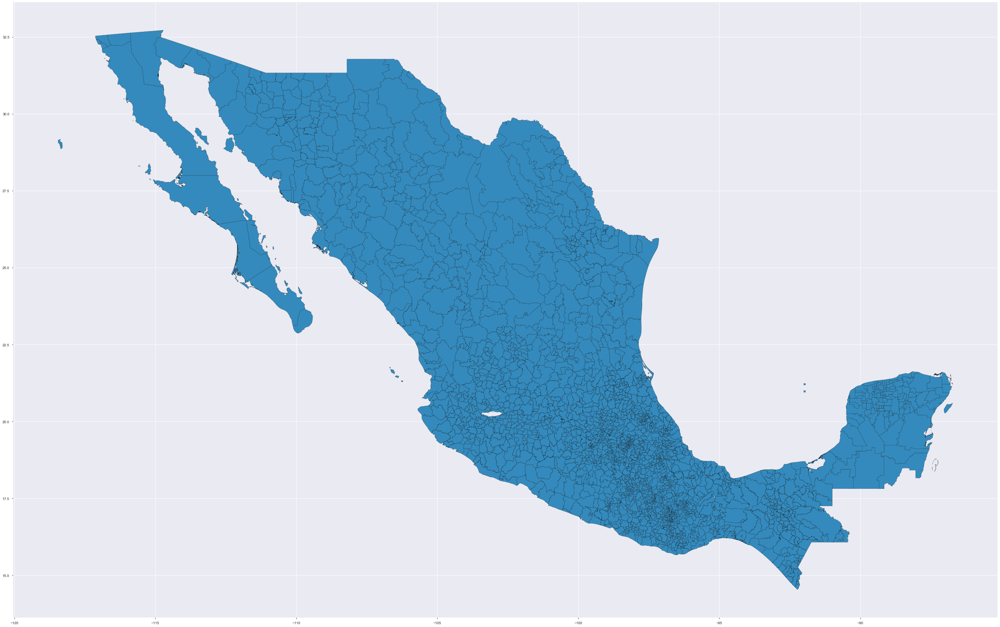

In [28]:
#muestra de la cartografía de municipios
plt.rcParams['figure.figsize'] = [50, 70]
mapa_mun.plot(edgecolor='black')

In [29]:
#se guarda shapefile en geojson
#mapa_mun.to_file("municipios.geojson", driver='GeoJSON')

In [30]:
#se lee el geojson para despues usar en plotly
import json
with open('C:/Users/miguel.alvarez/Google Drive/INFOTEC/Proyecto/Code-Data/Mun/4_Resumen-Mapas/municipios.geojson') as f:
    municipios_s = json.load(f)

#print(municipios_s["features"][0])
#print(municipios_s["features"][0]["properties"])
#municipios_s

In [31]:
#se carga la cartografía de estados (shapefile)
fp2 = "C:/Users/miguel.alvarez/Google Drive/Cartografias/Cartografia INE/entidad.shp"
mapa_edo = gpd.read_file(fp2)
#type(mapa_edo)
mapa_edo["id"] = mapa_edo["entidad"].astype(str)
mapa_edo.head()

,gid,id,entidad,nombre,circunscri,crc,padron,lnominal,geometry
0,129,1,1,AGUASCALIENTES,2,1,947129,939109,"POLYGON ((-102.29831 22.45985, -102.29599 22.4..."
1,130,2,2,BAJA CALIFORNIA,1,8,2745326,2717857,"MULTIPOLYGON (((-114.71429 32.72202, -114.7191..."
2,131,3,3,BAJA CALIFORNIA SUR,1,4,519170,514223,"MULTIPOLYGON (((-112.08233 25.34398, -112.0822..."
3,132,4,4,CAMPECHE,3,10,644487,637005,"MULTIPOLYGON (((-91.93864 21.23621, -91.93901 ..."
4,133,5,5,COAHUILA,2,11,2163696,2140471,"POLYGON ((-102.31629 29.87767, -102.31551 29.8..."


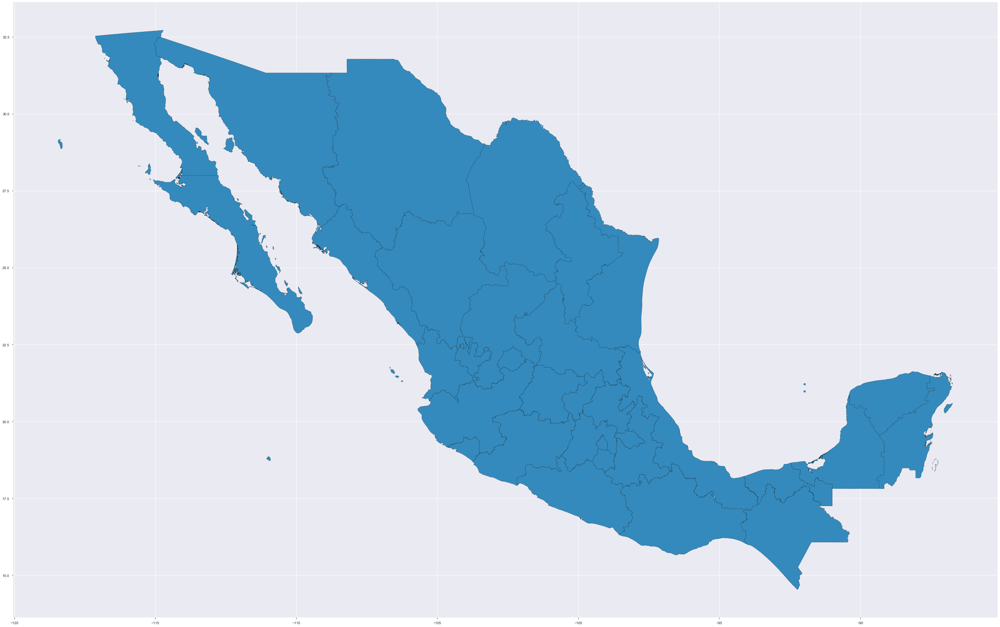

In [32]:
#muestra de la cartografía de estados
plt.rcParams['figure.figsize'] = [50, 70]
mapa_edo.plot(edgecolor='black')

<br>

## Escenario 1: Mapas de TCE y atipicidad (7 indicadores)

In [33]:
#se agrega una column id a resultados_ind7
resultados_ind7["id"] = resultados_ind7["EDO"].astype(str) + resultados_ind7["MUN"].astype(str)
#se une con mapa_mun
mapa_mun_ind7 = mapa_mun.merge(resultados_ind7, how='inner',on=['id'])
mapa_mun_ind7.head()

,gid,id,entidad,municipio,nombre,padron,lnominal,geometry,EDO,NOMBRE_ESTADO,...,Autocorr_LNE,CP1 (ICE principal),CP2 (segundo ICE),CP3 (tercer ICE),CP4,CP5,CP6,CP7,TCE_municipal,Atipicidad
0,26237,20246,20,246,SAN MATEO CAJONOS,442,434,"POLYGON ((-96.20930 17.17679, -96.20832 17.176...",20,OAXACA,...,0.929680,0.672843,-0.649025,-0.680460,-0.053429,-0.403842,0.129748,0.528983,G1,Tipica
1,26008,1693,16,93,TIQUICHEO DE NICOLAS ROMERO,10078,9986,"POLYGON ((-100.99616 19.35860, -100.99496 19.3...",16,MICHOACAN,...,0.911267,-0.918999,-0.145389,0.934514,-0.477477,-0.256412,0.206542,0.145292,G1,Tipica
2,26009,1694,16,94,TLALPUJAHUA,19592,19464,"POLYGON ((-100.20480 19.86997, -100.20440 19.8...",16,MICHOACAN,...,0.987595,-0.544816,0.054620,1.021409,-0.245210,-0.623674,0.139644,0.221885,G1,Tipica
3,26010,1695,16,95,TLAZAZALCA,7961,7857,"POLYGON ((-102.13541 20.10089, -102.13356 20.1...",16,MICHOACAN,...,0.986573,-0.641659,-0.093245,0.241625,-0.753764,-0.873486,0.241747,0.340679,G1,Tipica
4,26030,16103,16,103,URUAPAN,240661,239144,"POLYGON ((-102.12733 19.62702, -102.12708 19.6...",16,MICHOACAN,...,0.995865,0.128755,1.707311,0.530208,0.143466,0.516620,1.197788,0.116559,G1,Atípica en segundo ICE


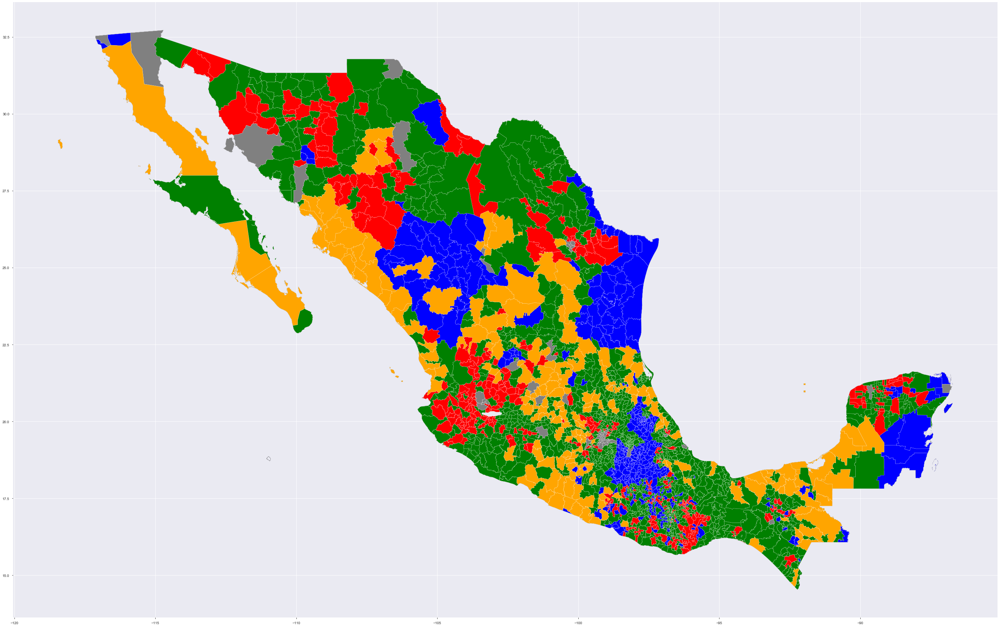

In [35]:
#mapa tipología
base = mapa_edo.plot(facecolor="none", edgecolor='black')
mapa_mun_ind7.plot(ax=base,
                   color=mapa_mun_ind7['TCE_municipal'].apply(lambda x: colors[x]),
                   categorical=True,
                   edgecolor='white',
                   legend=True)
plt.savefig('Pyplotly_Mapa_Mun_TCE_ind7.png', dpi=400, bbox_inches='tight')

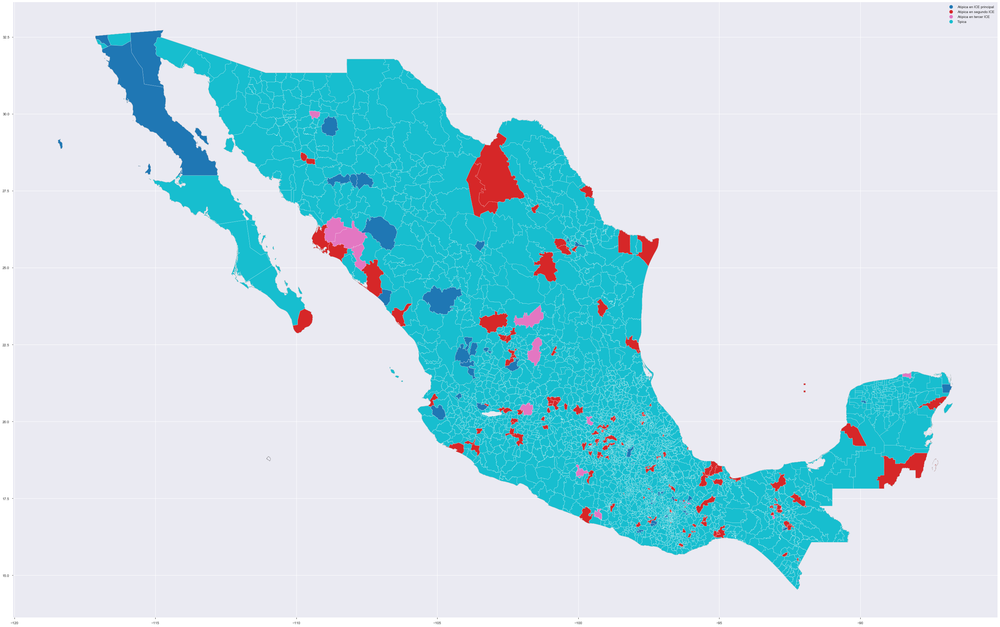

In [36]:
#mapa municipios atípicos
base = mapa_edo.plot(facecolor="none", edgecolor='black')
mapa_mun_ind7.plot(ax=base,
                   column='Atipicidad', 
                   categorical=True,
                   edgecolor='white',
                   legend=True)
plt.savefig('Pyplotly_Mapa_Mun_Ati_ind7.png', dpi=400, bbox_inches='tight')

<br>

## Escenario 2: Mapas de TCE y atipicidad (7 indicadores, con transformación log en LNE y Densidad_LNE)

In [37]:
#se agrega una column id a resultados_ind7_tf
resultados_ind7_tf["id"] = resultados_ind7_tf["EDO"].astype(str) + resultados_ind7_tf["MUN"].astype(str)
#se une con mapa_mun
mapa_mun_ind7_tf = mapa_mun.merge(resultados_ind7_tf, how='inner',on=['id'])
mapa_mun_ind7_tf

,gid,id,entidad,municipio,nombre,padron,lnominal,geometry,EDO,NOMBRE_ESTADO,...,Autocorr_LNE,CP1 (ICE principal),CP2 (segundo ICE),CP3 (tercer ICE),CP4,CP5,CP6,CP7,TCE_municipal,Atipicidad
0,26237,20246,20,246,SAN MATEO CAJONOS,442,434,"POLYGON ((-96.20930 17.17679, -96.20832 17.176...",20,OAXACA,...,0.929680,0.394713,-1.908439,-0.522982,-0.301210,0.469160,1.087860,0.545759,G2,Tipica
1,26008,1693,16,93,TIQUICHEO DE NICOLAS ROMERO,10078,9986,"POLYGON ((-100.99616 19.35860, -100.99496 19.3...",16,MICHOACAN,...,0.911267,-0.827582,0.421444,1.409070,-1.180230,-0.010746,-0.552620,0.126968,G3,Tipica
2,26009,1694,16,94,TLALPUJAHUA,19592,19464,"POLYGON ((-100.20480 19.86997, -100.20440 19.8...",16,MICHOACAN,...,0.987595,-0.461742,1.010252,0.254011,-0.377251,0.623931,-0.011420,0.212436,G3,Tipica
3,26010,1695,16,95,TLAZAZALCA,7961,7857,"POLYGON ((-102.13541 20.10089, -102.13356 20.1...",16,MICHOACAN,...,0.986573,-0.682258,0.211941,-0.618728,-0.579590,0.941054,0.089707,0.333205,G3,Tipica
4,26030,16103,16,103,URUAPAN,240661,239144,"POLYGON ((-102.12733 19.62702, -102.12708 19.6...",16,MICHOACAN,...,0.995865,0.456440,2.096458,-0.637441,0.272303,-0.156304,-0.867559,0.034614,G3,Tipica
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2455,27582,3245,32,45,TEPECHITLAN,7061,6994,"POLYGON ((-103.42536 21.72844, -103.42445 21.7...",32,ZACATECAS,...,0.959378,0.566375,-0.038837,1.137560,-0.402981,0.304617,0.000411,-0.066702,G3,Tipica
2456,27583,3214,32,14,GENERAL FRANCISCO R. MURGUIA,17495,17320,"POLYGON ((-102.96496 24.45706, -102.95228 24.4...",32,ZACATECAS,...,0.984897,1.080969,1.300230,2.208190,-0.057168,-0.342807,0.496959,-0.236424,G1,Tipica
2457,27584,3244,32,44,TABASCO,12599,12526,"POLYGON ((-102.94001 22.06462, -102.93933 22.0...",32,ZACATECAS,...,0.993335,1.911600,0.178614,0.950089,0.065079,-0.393423,0.058249,-0.192537,G2,Tipica
2458,27575,329,32,9,CHALCHIHUITES,8469,8392,"POLYGON ((-103.89917 23.61221, -103.89756 23.6...",32,ZACATECAS,...,0.988608,0.851114,0.072100,-0.200368,0.061119,0.545074,0.389442,-0.072882,G3,Tipica


In [38]:
mapa_mun_ind7_tf.id.nunique()

2457

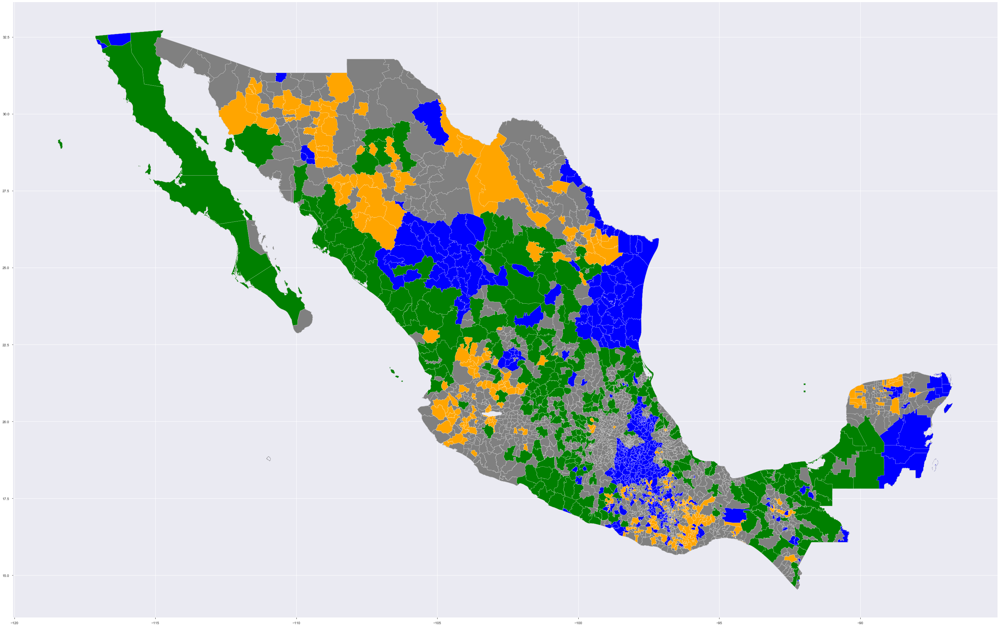

In [39]:
#mapa tipología
base = mapa_edo.plot(facecolor="none", edgecolor='black')
mapa_mun_ind7_tf.plot(ax=base,
                   color=mapa_mun_ind7_tf['TCE_municipal'].apply(lambda x: colors[x]),
                   categorical=True,
                   edgecolor='white',
                   legend=True)
plt.savefig('Pyplotly_Mapa_Mun_TCE_ind7_tf.png', dpi=400, bbox_inches='tight')

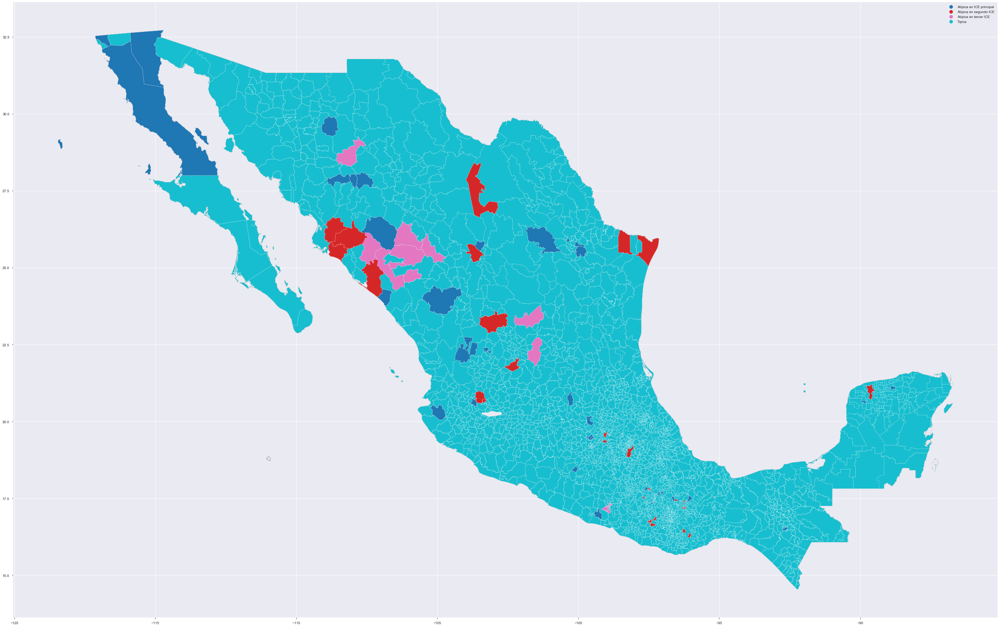

In [40]:
#mapa municipios atípicos
base = mapa_edo.plot(facecolor="none", edgecolor='black')
mapa_mun_ind7_tf.plot(ax=base,
                   column='Atipicidad', 
                   categorical=True,
                   edgecolor='white',
                   legend=True)
plt.savefig('Pyplotly_Mapa_Mun_Ati_ind7_tf.png', dpi=400, bbox_inches='tight')

<br>

## Escenario 3: Mapas de TCE y atipicidad (8 indicadores)

In [41]:
#se agrega una column id a resultados_ind8
resultados_ind8["id"] = resultados_ind8["EDO"].astype(str) + resultados_ind8["MUN"].astype(str)
#se une con mapa_mun
mapa_mun_ind8 = mapa_mun.merge(resultados_ind8, how='inner',on=['id'])
mapa_mun_ind8.head()

,gid,id,entidad,municipio,nombre,padron,lnominal,geometry,EDO,NOMBRE_ESTADO,...,CP1 (ICE principal),CP2 (segundo ICE),CP3 (tercer ICE),CP4,CP5,CP6,CP7,CP8,TCE_municipal,Atipicidad
0,26237,20246,20,246,SAN MATEO CAJONOS,442,434,"POLYGON ((-96.20930 17.17679, -96.20832 17.176...",20,OAXACA,...,0.885475,-0.623478,0.565450,-0.182090,0.420081,0.057839,0.580609,-0.023896,G2,Tipica
1,26008,1693,16,93,TIQUICHEO DE NICOLAS ROMERO,10078,9986,"POLYGON ((-100.99616 19.35860, -100.99496 19.3...",16,MICHOACAN,...,-1.382016,-0.159336,-0.905808,-0.402233,0.100490,0.157929,0.202828,0.026815,G1,Tipica
2,26009,1694,16,94,TLALPUJAHUA,19592,19464,"POLYGON ((-100.20480 19.86997, -100.20440 19.8...",16,MICHOACAN,...,-1.086294,0.069462,-1.048926,-0.240565,0.521354,0.048467,0.311244,0.029833,G1,Tipica
3,26010,1695,16,95,TLAZAZALCA,7961,7857,"POLYGON ((-102.13541 20.10089, -102.13356 20.1...",16,MICHOACAN,...,-1.179780,-0.092692,-0.323507,-0.831047,0.745179,0.112123,0.471792,-0.000325,G1,Tipica
4,26030,16103,16,103,URUAPAN,240661,239144,"POLYGON ((-102.12733 19.62702, -102.12708 19.6...",16,MICHOACAN,...,0.081443,1.714451,-0.441084,0.250855,-0.447659,1.239740,0.136290,-0.021474,G1,Atípica en segundo ICE


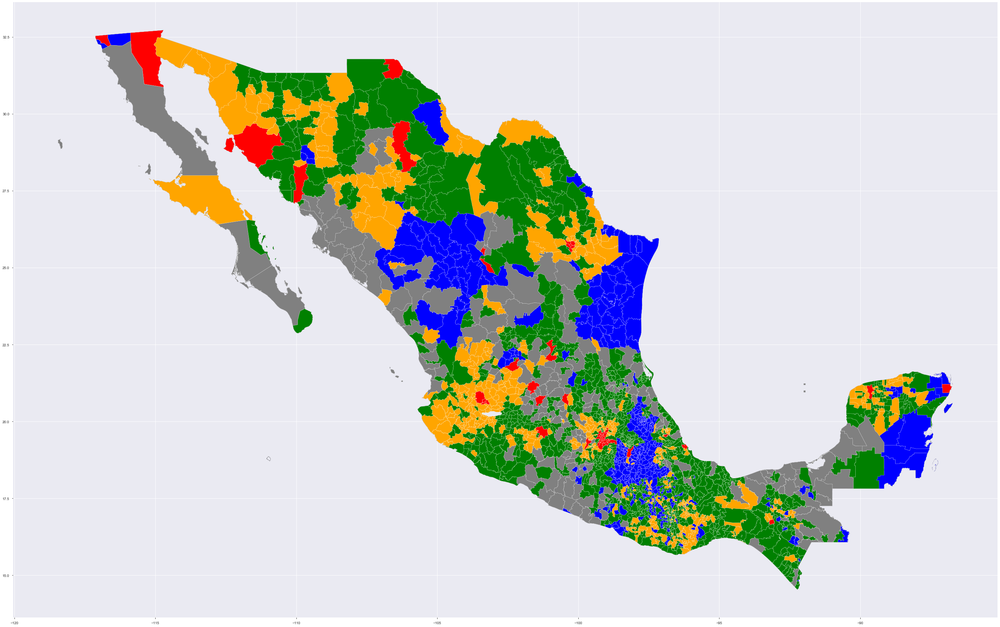

In [42]:
#mapa tipología
base = mapa_edo.plot(facecolor="none", edgecolor='black')
mapa_mun_ind8.plot(ax=base,
                    color=mapa_mun_ind8['TCE_municipal'].apply(lambda x: colors[x]),
                    categorical=True,
                    edgecolor='white',
                    legend=True)
plt.savefig('Pyplotly_Mapa_Mun_TCE_ind8.png', dpi=400, bbox_inches='tight')

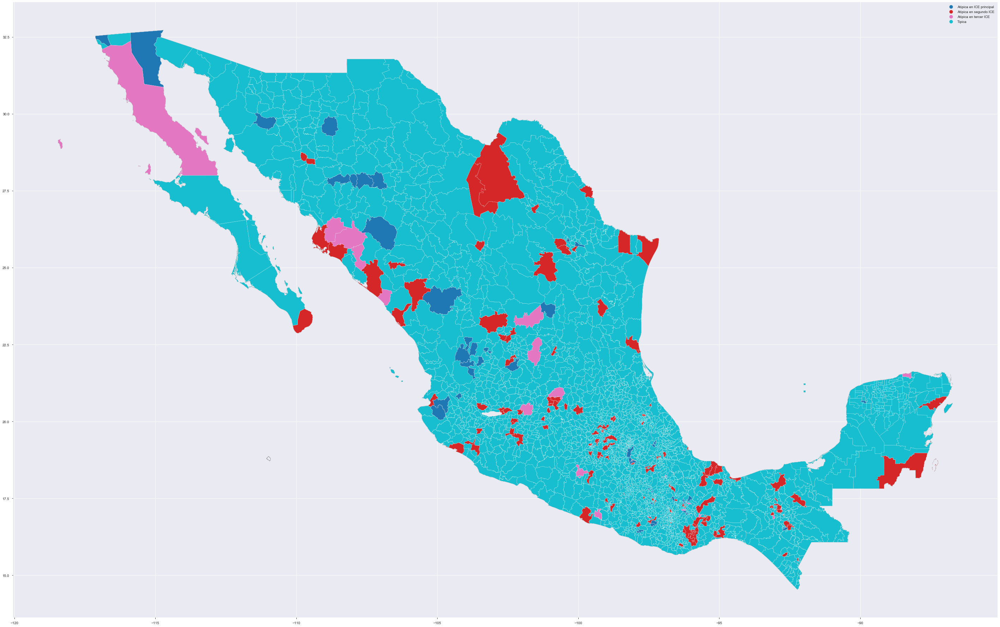

In [43]:
#mapa municipios atípicos
base = mapa_edo.plot(facecolor="none", edgecolor='black')
mapa_mun_ind8.plot(ax=base,
                   column='Atipicidad', 
                   categorical=True,
                   edgecolor='white',
                   legend=True)
plt.savefig('Pyplotly_Mapa_Mun_Ati_ind8.png', dpi=400, bbox_inches='tight')

<br>

## Escenario 4: Mapas de TCE y atipicidad (8 indicadores, con previa transformación log en LNE y Densidad_LNE)

In [44]:
#se agrega una column id a resultados_ind8
resultados_ind8_tf["id"] = resultados_ind8_tf["EDO"].astype(str) + resultados_ind8_tf["MUN"].astype(str)
#se une con mapa_mun
mapa_mun_ind8_tf = mapa_mun.merge(resultados_ind8_tf, how='inner',on=['id'])
mapa_mun_ind8_tf.head()

,gid,id,entidad,municipio,nombre,padron,lnominal,geometry,EDO,NOMBRE_ESTADO,...,CP1 (ICE principal),CP2 (segundo ICE),CP3 (tercer ICE),CP4,CP5,CP6,CP7,CP8,TCE_municipal,Atipicidad
0,26237,20246,20,246,SAN MATEO CAJONOS,442,434,"POLYGON ((-96.20930 17.17679, -96.20832 17.176...",20,OAXACA,...,0.870239,-1.785939,-0.446299,-0.498344,0.398218,1.080355,0.619802,-0.053381,G1,Tipica
1,26008,1693,16,93,TIQUICHEO DE NICOLAS ROMERO,10078,9986,"POLYGON ((-100.99616 19.35860, -100.99496 19.3...",16,MICHOACAN,...,-1.368652,0.305900,1.425000,-1.004334,-0.349177,-0.554747,0.154593,0.030138,G3,Tipica
2,26009,1694,16,94,TLALPUJAHUA,19592,19464,"POLYGON ((-100.20480 19.86997, -100.20440 19.8...",16,MICHOACAN,...,-1.107692,0.946496,0.265737,-0.442513,0.497076,-0.018957,0.302315,0.032862,G1,Tipica
3,26010,1695,16,95,TLAZAZALCA,7961,7857,"POLYGON ((-102.13541 20.10089, -102.13356 20.1...",16,MICHOACAN,...,-1.209702,0.124730,-0.576954,-0.765417,0.780546,0.078315,0.471708,-0.001835,G1,Tipica
4,26030,16103,16,103,URUAPAN,240661,239144,"POLYGON ((-102.12733 19.62702, -102.12708 19.6...",16,MICHOACAN,...,0.144048,2.121118,-0.684409,0.337463,-0.145789,-0.866137,0.007712,0.004378,G1,Tipica


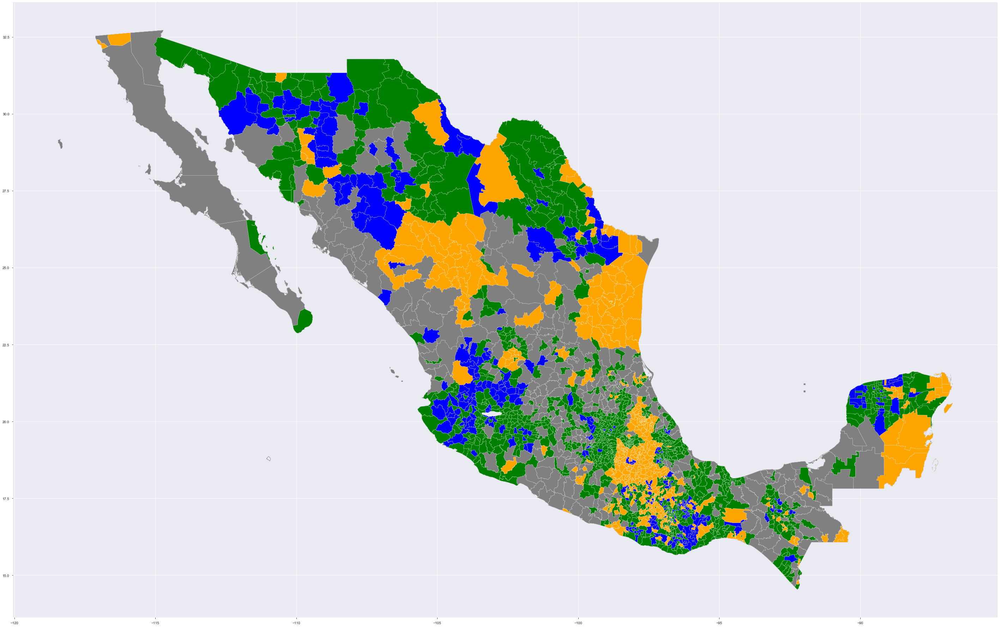

In [45]:
#mapa tipología
base = mapa_edo.plot(facecolor="none", edgecolor='black')
mapa_mun_ind8_tf.plot(ax=base,
                    color=mapa_mun_ind8_tf['TCE_municipal'].apply(lambda x: colors[x]),
                    categorical=True,
                    edgecolor='white',
                    legend=True)
plt.savefig('Pyplotly_Mapa_Mun_TCE_ind8_tf.png', dpi=400, bbox_inches='tight')

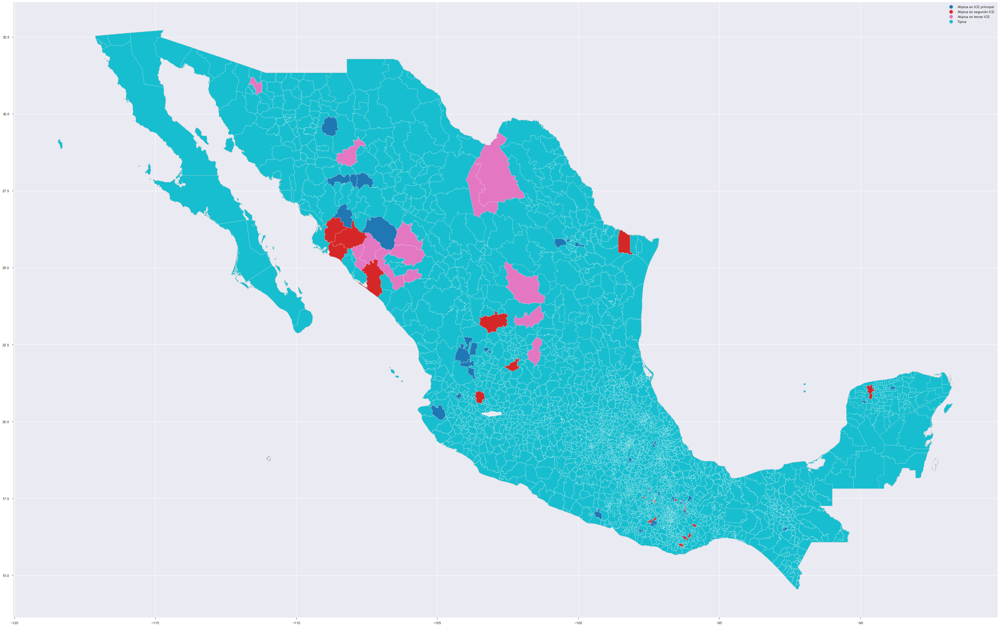

In [46]:
#mapa municipios atípicos
base = mapa_edo.plot(facecolor="none", edgecolor='black')
mapa_mun_ind8_tf.plot(ax=base,
                   column='Atipicidad', 
                   categorical=True,
                   edgecolor='white',
                   legend=True)
plt.savefig('Pyplotly_Mapa_Mun_Ati_ind8_tf.png', dpi=400, bbox_inches='tight')

<br>

# Mapas con plotly

## Escenario 1

In [47]:
#mapa de TCE (demasiado pesado el archivo para visualizar en explorador)
# eti=['NOMBRE_ESTADO','NUM_SECC_RUR', 'LNE', 'Densidad_LNE', 'Razon_LNE_PE', 'TC_LNE_2019', 'Coef_Var_LNE', 'Autocorr_LNE', 'CP1 (ICE principal)', 'CP2 (segundo ICE)', 'CP3 (tercer ICE)', 'TCE_municipal', 'Atipicidad']
# fig = px.choropleth(resultados_ind7, geojson=municipios_s, 
#                     locations='id', featureidkey="properties.id",
#                     color='TCE_municipal',
#                     color_discrete_map={
#                   'G0':'blue',
#                   'G1':'green',
#                   'G2': 'orange',
#                   'G3': 'grey',
#                   'G4': 'red',
#                   'G5': 'magenta'},
#                     hover_name='NOMBRE_MUNICIPIO',
#                     hover_data = eti,
#                     title = 'TCE municipal (7 indicadores)')
# fig.update_geos(fitbounds="locations",
#                 visible=False,
#                 showcountries=True, 
#                 countrycolor="Black", showsubunits=True, 
#                 subunitcolor="Blue")
# #fig.show()
# fig.write_html("C:/Users/miguel.alvarez/Google Drive/INFOTEC/Proyecto/Code-Data/Mun/4_Resumen-Mapas/Pyplotly_Mapa_Mun_ind7.html")

## Escenario 2

In [48]:
#mapa de TCE
# eti=['NOMBRE_ESTADO','NUM_SECC_RUR', 'LNE', 'Densidad_LNE', 'Razon_LNE_PE', 'TC_LNE_2019', 'Coef_Var_LNE', 'Autocorr_LNE', 'CP1 (ICE principal)', 'CP2 (segundo ICE)', 'CP3 (tercer ICE)', 'TCE_municipal', 'Atipicidad']
# fig = px.choropleth(resultados_ind7_tf, geojson=municipios_s, 
#                     locations='id', featureidkey="properties.id",
#                     color='TCE_municipal',
#                     color_discrete_map={
#                   'G0':'blue',
#                   'G1':'green',
#                   'G2': 'orange',
#                   'G3': 'grey',
#                   'G4': 'red',
#                   'G5': 'magenta'},
#                     hover_name='NOMBRE_MUNICIPIO',
#                     hover_data = eti,
#                     title = 'TCE municipal (7 indicadores, con transformación log en LNE y Densidad_LNE)')
# fig.update_geos(fitbounds="locations",
#                 visible=False,
#                 showcountries=True, 
#                 countrycolor="Black", showsubunits=True, 
#                 subunitcolor="Blue")
# #fig.show()
# fig.write_html("C:/Users/miguel.alvarez/Google Drive/INFOTEC/Proyecto/Code-Data/Mun/4_Resumen-Mapas/Pyplotly_Mapa_Mun_ind7_tf.html")

In [49]:
# #mapa de atipicidad
# eti=['NOMBRE_ESTADO','NUM_SECC_RUR', 'LNE', 'Densidad_LNE', 'Razon_LNE_PE', 'TC_LNE_2019', 'Coef_Var_LNE','Autocorr_LNE', 'CP1 (ICE principal)', 'CP2 (segundo ICE)', 'CP3 (tercer ICE)', 'TCE_municipal', 'Atipicidad']
# fig = px.choropleth(resultados_ind7_tf, geojson=municipios_s, 
#                     locations='id', featureidkey="properties.id",
#                     color='Atipicidad',
#                     color_discrete_sequence= px.colors.sequential.Reds,
#                     hover_name='NOMBRE_MUNICIPIO',
#                     hover_data = eti,
#                     title = 'Mapa municipios atípicos (7 indicadores, con transformación log en LNE y Densidad_LNE)')
# fig.update_geos(fitbounds="locations",
#                 visible=True,
#                 showcountries=True, 
#                 countrycolor="Black", 
#                 showsubunits=True, 
#                 subunitcolor="Blue")
# #fig.show()
# fig.write_html("C:/Users/miguel.alvarez/Google Drive/INFOTEC/Proyecto/Code-Data/Mun/4_Resumen-Mapas/Pyplotly_Mapa_Mun_Atip_ind7_tf.html")

## Escenario 3

In [50]:
# #mapa de TCE
# eti=['NOMBRE_ESTADO','NUM_SECC_RUR', 'LNE', 'Densidad_LNE', 'Razon_LNE_PE', 'TC_LNE_2019', 'Coef_Var_LNE', 'Var_Prop_LNE', 'Autocorr_LNE', 'CP1 (ICE principal)', 'CP2 (segundo ICE)', 'CP3 (tercer ICE)', 'TCE_municipal', 'Atipicidad']
# fig = px.choropleth(resultados_ind8, geojson=municipios_s, 
#                     locations='id', featureidkey="properties.id",
#                     color='TCE_municipal',
#                     color_discrete_map={
#                   'G0':'blue',
#                   'G1':'green',
#                   'G2': 'orange',
#                   'G3': 'grey',
#                   'G4': 'red',
#                   'G5': 'magenta'},
#                     hover_name='NOMBRE_MUNICIPIO',
#                     hover_data = eti,
#                     title = 'TCE municipal (8 indicadores)')
# fig.update_geos(fitbounds="locations",
#                 visible=False,
#                 showcountries=True, 
#                 countrycolor="Black", showsubunits=True, 
#                 subunitcolor="Blue")
# #fig.show()
# fig.write_html("C:/Users/miguel.alvarez/Google Drive/INFOTEC/Proyecto/Code-Data/Mun/4_Resumen-Mapas/Pyplotly_Mapa_Mun_ind8.html")

## Escenario 4

In [51]:
# #mapa de TCE
# eti=['NOMBRE_ESTADO','NUM_SECC_RUR', 'LNE', 'Densidad_LNE', 'Razon_LNE_PE', 'TC_LNE_2019', 'Coef_Var_LNE', 'Var_Prop_LNE', 'Autocorr_LNE', 'CP1 (ICE principal)', 'CP2 (segundo ICE)', 'CP3 (tercer ICE)', 'TCE_municipal', 'Atipicidad']
# fig = px.choropleth(resultados_ind8_tf, geojson=municipios_s, 
#                     locations='id', featureidkey="properties.id",
#                     color='TCE_municipal',
#                     color_discrete_map={
#                   'G0':'blue',
#                   'G1':'green',
#                   'G2': 'orange',
#                   'G3': 'grey',
#                   'G4': 'red',
#                   'G5': 'magenta'},
#                     hover_name='NOMBRE_MUNICIPIO',
#                     hover_data = eti,
#                     title = 'TCE municipal (8 indicadores, con transformación log en LNE y Densidad_LNE)')
# fig.update_geos(fitbounds="locations",
#                 visible=False,
#                 showcountries=True, 
#                 countrycolor="Black", showsubunits=True, 
#                 subunitcolor="Blue")
# #fig.show()
# fig.write_html("C:/Users/miguel.alvarez/Google Drive/INFOTEC/Proyecto/Code-Data/Mun/4_Resumen-Mapas/Pyplotly_Mapa_Mun_ind8_tf.html")

In [52]:
# #mapa de atipicidad
# eti=['NOMBRE_ESTADO','NUM_SECC_RUR', 'LNE', 'Densidad_LNE', 'Razon_LNE_PE', 'TC_LNE_2019', 'Coef_Var_LNE', 'Var_Prop_LNE', 'Autocorr_LNE', 'CP1 (ICE principal)', 'CP2 (segundo ICE)', 'CP3 (tercer ICE)', 'TCE_municipal', 'Atipicidad']
# fig = px.choropleth(resultados_ind8_tf, geojson=municipios_s, 
#                     locations='id', featureidkey="properties.id",
#                     color='Atipicidad',
#                     color_discrete_sequence= px.colors.sequential.Reds,
#                     hover_name='NOMBRE_MUNICIPIO',
#                     hover_data = eti,
#                     title = 'Mapa municipios atípicos (8 indicadores, con transformación log en LNE y Densidad_LNE)')
# fig.update_geos(fitbounds="locations",
#                 visible=False,
#                 showcountries=True, 
#                 countrycolor="Black", 
#                 showsubunits=True, 
#                 subunitcolor="Blue")
# #fig.show()
# fig.write_html("C:/Users/miguel.alvarez/Google Drive/INFOTEC/Proyecto/Code-Data/Mun/4_Resumen-Mapas/Pyplotly_Mapa_Mun_Atip_ind8_tf.html")

# Referencias

- https://stackoverflow.com/questions/60870063/plotly-express-choropleth-for-country-regions
- https://plotly.github.io/plotly.py-docs/generated/plotly.express.choropleth.html
- https://plotly.com/python/builtin-colorscales/#builtin-sequential-color-scales
- https://plotly.com/python/map-configuration/